# Overview of SERTO

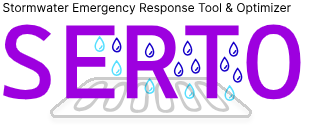

## Workflow

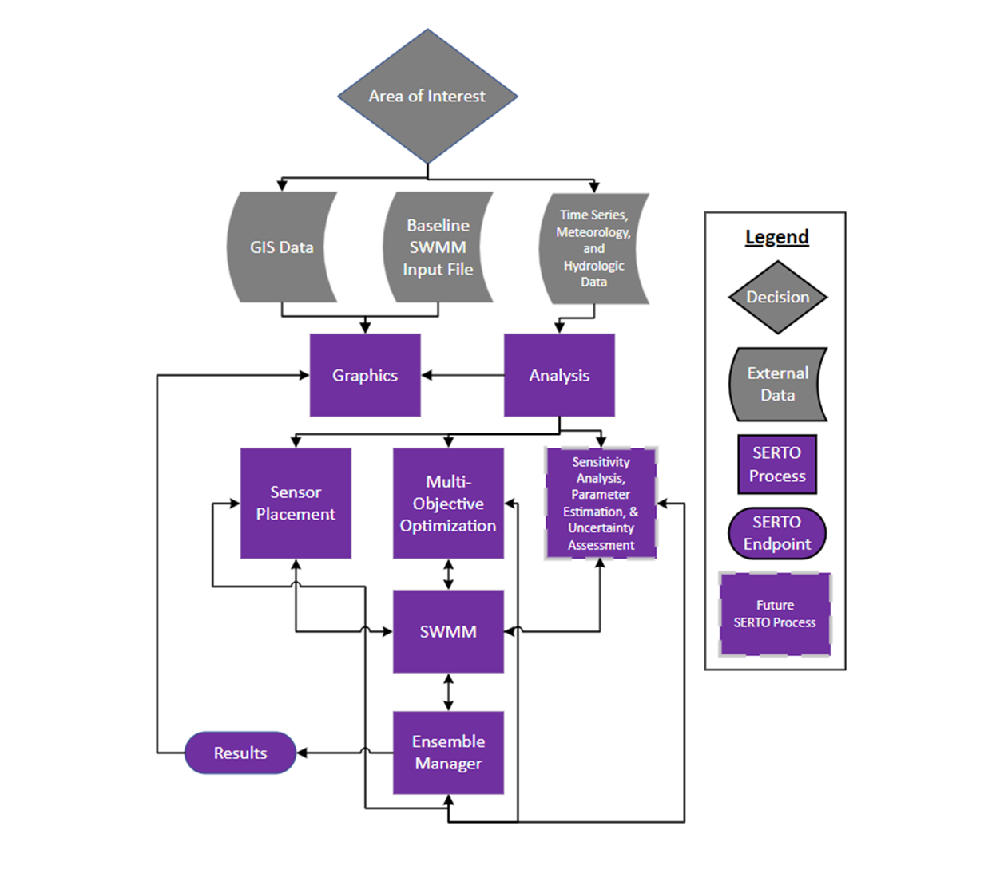

## Area of Interest

Define area of interest and understand the geographic setting of the study area using freely available geospatial datasets. Here, we use the National Hydrography Plus Dataset (NHDPlus) as an example. 

In [1]:
# python imports
import os 

# third-party imports
import plotly.offline as pyo
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from plotly.offline import init_notebook_mode, iplot
from serto.swmm import SpatialSWMM
from serto.graphics.swmm import *
import contextily as ctx
import matplotlib.pyplot as plt
import geopandas as gpd
import pandas as pd
import numpy as np
import plotly.figure_factory as ff

# local imports
import warnings
warnings.filterwarnings('ignore')

init_notebook_mode(connected=True)

In [2]:
DATA_DIR =  r'..\tests\data\licking'

fig = go.Figure()

minor_civil_divisions = gpd.read_file(os.path.join(DATA_DIR, 'GU_MinorCivilDivision_NKY.shp')).to_crs('EPSG:4326')
hydro_net_junctions = gpd.read_file(os.path.join(DATA_DIR, 'HYDRO_NET_Junctions_NKY.shp')).to_crs('EPSG:4326')
flow_lines = gpd.read_file(os.path.join(DATA_DIR, 'NHDFlowline_NKY.shp')).to_crs('EPSG:4326')
model_boundary = gpd.read_file(os.path.join(DATA_DIR, 'Subcatchments.shp')).to_crs('EPSG:4326')

# flow lines where gnis_name is not null
flow_lines = flow_lines[flow_lines['gnis_name'].notnull()]

flow_lines.head(10)

# Extract lat and lon from geometry
hydro_net_junctions['Latitude'] = hydro_net_junctions.geometry.y
hydro_net_junctions['Longitude'] = hydro_net_junctions.geometry.x

# Center map on centroid of nodes
minor_civil_divisions_centroid = minor_civil_divisions.dissolve().centroid
lon = minor_civil_divisions_centroid.geometry.x[0]
lat = minor_civil_divisions_centroid.geometry.y[0]

minor_civil_divisions_geo = minor_civil_divisions.drop(columns='geometry')
hydro_net_junctions_geo = hydro_net_junctions.drop(columns='geometry')
flow_lines_geo = flow_lines.drop(columns='geometry')
model_boundary_geo = model_boundary.drop(columns='geometry')
eligible_columns = model_boundary_geo.columns[:20]
model_boundary_geo = model_boundary_geo[eligible_columns]

fig.add_trace(
    go.Choroplethmap(
        name='Minor Civil Divisions',
        geojson=minor_civil_divisions.__geo_interface__,
        locations=minor_civil_divisions.index,
        z=[1] * len(minor_civil_divisions),
        colorscale=[[0, 'salmon'], [1, 'salmon']],
        hovertemplate='<br>'.join([
            f'<b>{col}</b>: %{{customdata[{i}]}}' for i, col in enumerate(minor_civil_divisions_geo.columns)
        ]),
        text=minor_civil_divisions_geo['gnis_name'],
        customdata=minor_civil_divisions_geo.values,
        marker_opacity=0.25,
        marker_line_width=2,
        showscale=False,
        showlegend=True,
    )
)

# fig.add_trace(
#     go.Scattermap(
#         name='Hydro Net Junctions',
#         lon=hydro_net_junctions_geo['Longitude'],
#         lat=hydro_net_junctions_geo['Latitude'],
#         mode='markers',
#         marker=dict(
#             size=3.0,
#             color='gray',
#             # opacity=0.5
#         ),
#         hovertemplate='<br>'.join([
#             f'<b>{col}</b>: %{{customdata[{i}]}}' for i, col in enumerate(hydro_net_junctions_geo.columns)
#         ]),
#         customdata=hydro_net_junctions_geo.values,
#     )
# )
fig.add_trace(
    go.Choroplethmap(
        name='SWMM Model Subcatchments',
        geojson=model_boundary.__geo_interface__,
        locations=model_boundary.index,
        z=[1] * len(model_boundary),
        colorscale=[[0, 'gray'], [1, 'gray']],
        hovertemplate='<br>'.join([
            f'<b>{col}</b>: %{{customdata[{i}]}}' for i, col in enumerate(model_boundary_geo.columns[:10])
        ]),
        text=model_boundary_geo['NAME'],
        customdata=model_boundary_geo.values[:10],
        marker_opacity=0.25,
        marker_line_width=2,
        showscale=False,
        showlegend=True,
    )
)

first = True
link_traces = []

for index, row in flow_lines.iterrows():
    new_row = flow_lines_geo.loc[index]
    geometry = row['geometry']
    link_traces.append(
        go.Scattermap(
            name="Flow Lines",
            lon=[coord[0] for coord in geometry.coords],
            lat=[coord[1] for coord in geometry.coords],
            mode='lines',
            line=dict(
                width=2, 
                color='blue'
            ),
            hovertemplate='<br>'.join([
                f'<b>{col}</b>: %{{customdata[{i}]}}' for i, col in enumerate(new_row.index)
            ]),
            customdata=new_row.values,
            showlegend=first,
            legendgroup='flow_lines',
        )       
    )

    first = False

fig.add_traces(link_traces)

fig.update_layout(
    title=f'Area of Interest',
    map_style="carto-positron",
    showlegend=True,
    height=800,
    map = {
        'center': {'lon': lon, 'lat': lat},
        'zoom': 10
    }
)

fig.show()

## Weather Analysis Summarization

Plotting times to weather data to identify gaps and potential anomalies for remediation.



### Rainfall data

Plot rainfall timeseries data and heat map to identify potential gaps.

In [3]:
rainfall_data_path = r'..\tests\analysis\precipitation\cvg_precip.csv'
rainfall_data = pd.read_csv(rainfall_data_path, index_col=0, parse_dates=True)['2005-01-01':].resample(pd.Timedelta(hours=1)).sum()

rainfall_figure = go.Figure()
for column in rainfall_data.columns:
    rainfall_figure.add_trace(
        go.Scattergl(
            x=rainfall_data.index,
            y=rainfall_data[column],
            mode='lines',
            line=dict(
            ),
            marker=dict(),
            name=column
        )       
    )

rainfall_figure.update_layout(
    title='Rainfall Data',
    xaxis_title='Time',
    yaxis_title='Rainfall (inches)',
    height=800,
    xaxis=dict(
        rangeslider=dict(visible=True),
    ),
    showlegend=True
)

rainfall_figure.show()

### Wind Data 

Plot wind time series

In [4]:
from serto.graphics.analysis.wind import WindVisualization

wind_data_path = r'..\tests\analysis\wind\wind_data.csv'
wind_data = pd.read_csv(
    wind_data_path,
    index_col="TimeEST",
    parse_dates=["TimeEST"]
)

wind_data = wind_data.drop(columns=['station', 'station_name'])

# remove duplicate indexes and sort
wind_data = wind_data[~wind_data.index.duplicated(keep='first')]
wind_data = wind_data.sort_index()

wind_fig =WindVisualization.plot_wind_timeseries(
    wind_data=wind_data['2010-01-01':],
)

wind_fig.show()


## Data Analysis

Various analysis tools for analyzing weather and hydrologic timeseries datasets are available.

### Rainfall Events Summary

For rainfall, users can extract events, calculate return periods, sample from events, and extract return period information automatically from NOAA Atlas 14 and in the future from NOAA Atlas 15.

Extract rainfall events using SERTO

In [5]:
from serto.analysis.precipitation import PrecipitationAnalysis
from serto.graphics.analysis.precipitation import PrecipitationVisualization


events = PrecipitationAnalysis.get_events(
    rainfall=rainfall_data,
    inter_event_time=pd.Timedelta(days=1),
    floor=0.012,
)

events.head(5)



,name,start,end,actual_end,duration,post_event_time,antecedent_event_time,precip_peak,precip_total
0,2005Jan03T08,2005-01-03 08:00:00,2005-01-04 13:00:00,2005-01-04 04:00:00,0 days 20:00:00,0 days 15:00:00,2 days 08:00:00,0.37,1.02
1,2005Jan04T19,2005-01-04 19:00:00,2005-01-07 04:00:00,2005-01-06 07:00:00,1 days 12:00:00,1 days 19:00:00,0 days 15:00:00,0.23,3.00
2,2005Jan08T02,2005-01-08 02:00:00,2005-01-08 22:00:00,2005-01-08 03:00:00,0 days 01:00:00,3 days 10:00:00,1 days 19:00:00,0.09,0.14
3,2005Jan11T13,2005-01-11 13:00:00,2005-01-12 02:00:00,2005-01-11 19:00:00,0 days 06:00:00,1 days 23:00:00,3 days 10:00:00,0.09,0.15
4,2005Jan13T18,2005-01-13 18:00:00,2005-01-14 17:00:00,2005-01-13 19:00:00,0 days 01:00:00,7 days 00:00:00,1 days 23:00:00,0.15,0.17


CHAMA allows integration of event probabilities and so getting return period information from NOAA Atlas 14 webservice.

In [6]:
events = PrecipitationAnalysis.get_noaa_event_return_periods(
    events=events,
    latitude=39.049774180652236,
    longitude=-84.66127045790225,
    series='ams',
)

events.head(5)


,name,start,end,actual_end,duration,post_event_time,antecedent_event_time,precip_peak,precip_total,return_period
0,2005Jan03T08,2005-01-03 08:00:00,2005-01-04 13:00:00,2005-01-04 04:00:00,0 days 20:00:00,0 days 15:00:00,2 days 08:00:00,0.37,1.02,0.781609
1,2005Jan04T19,2005-01-04 19:00:00,2005-01-07 04:00:00,2005-01-06 07:00:00,1 days 12:00:00,1 days 19:00:00,0 days 15:00:00,0.23,3.00,2.086207
2,2005Jan08T02,2005-01-08 02:00:00,2005-01-08 22:00:00,2005-01-08 03:00:00,0 days 01:00:00,3 days 10:00:00,1 days 19:00:00,0.09,0.14,0.21374
3,2005Jan11T13,2005-01-11 13:00:00,2005-01-12 02:00:00,2005-01-11 19:00:00,0 days 06:00:00,1 days 23:00:00,3 days 10:00:00,0.09,0.15,0.150754
4,2005Jan13T18,2005-01-13 18:00:00,2005-01-14 17:00:00,2005-01-13 19:00:00,0 days 01:00:00,7 days 00:00:00,1 days 23:00:00,0.15,0.17,0.259542


Clustering rainfall events by total, peak, and duration

In [7]:
events['duration_hours'] = events['duration'] / pd.Timedelta(hours=1)

events, clustering_model = PrecipitationAnalysis.cluster_events(
    events=events,
    cluster_columns=['precip_total', 'precip_peak', 'duration_hours'],
    number_of_clusters=6,
)

events.head(5)



,name,start,end,actual_end,duration,post_event_time,antecedent_event_time,precip_peak,precip_total,return_period,duration_hours,cluster,probability,likelihood
0,2005Jan03T08,2005-01-03 08:00:00,2005-01-04 13:00:00,2005-01-04 04:00:00,0 days 20:00:00,0 days 15:00:00,2 days 08:00:00,0.37,1.02,0.781609,20.0,2,0.974304,3.248917
1,2005Jan04T19,2005-01-04 19:00:00,2005-01-07 04:00:00,2005-01-06 07:00:00,1 days 12:00:00,1 days 19:00:00,0 days 15:00:00,0.23,3.00,2.086207,36.0,1,0.999986,-1.244703
2,2005Jan08T02,2005-01-08 02:00:00,2005-01-08 22:00:00,2005-01-08 03:00:00,0 days 01:00:00,3 days 10:00:00,1 days 19:00:00,0.09,0.14,0.21374,1.0,0,0.954096,6.666148
3,2005Jan11T13,2005-01-11 13:00:00,2005-01-12 02:00:00,2005-01-11 19:00:00,0 days 06:00:00,1 days 23:00:00,3 days 10:00:00,0.09,0.15,0.150754,6.0,5,0.991775,4.591547
4,2005Jan13T18,2005-01-13 18:00:00,2005-01-14 17:00:00,2005-01-13 19:00:00,0 days 01:00:00,7 days 00:00:00,1 days 23:00:00,0.15,0.17,0.259542,1.0,0,0.978982,6.882544


In [8]:
figures = PrecipitationVisualization.plot_precipitation(
    precipitation=rainfall_data,
    events=events,
    plot_clusters=True,
    show=True
)

for fig in figures:
    fig.update_layout(
        height=800,
        legend=dict(
            title='Event Clusters (k=6)',
        ),
        legend_tracegroupgap=10,
    )
    fig.show()


In [9]:
event_figs = PrecipitationVisualization.plot_events(
    events=events,
    event_plot_attributes=['precip_total', 'precip_peak', 'duration_hours', 'return_period', 'probability'],
    event_plot_attribute_labels=['Total Precipitation (inches)', 'Peak Precipitation (inches/hour)', 'Duration (hours)', 'Return Period (years)', 'Probability'],
    plot_clusters=True,
)

for event in event_figs:
    event[0].update_layout(
        height=1000,
    )
    event[0].show()
    if event[1]:
        event[1].update_layout(
            height=1000
        )
        event[1].show()

### Wind Speed and Direction Analysis

In [11]:
wind_rose_scatter = WindVisualization.plot_wind_scatter_polar(
    wind_data=wind_data,
    wind_speed_col='sknt',
    wind_dir_col='drct',
)

wind_rose_polar = WindVisualization.plot_wind_rose_bar_polar(
    wind_data=wind_data,
    wind_speed_col='sknt',
    wind_dir_col='drct',
)

fig = make_subplots(
    rows=1, cols=2,
    specs=[[{'type': 'polar'}, {'type': 'polar'}]]
)

fig.add_traces(wind_rose_polar, rows=1, cols=1)

fig.add_traces(wind_rose_scatter, rows=1, cols=2)

# fig = go.Figure([*wind_rose_polar, *wind_rose_scatter])

fig.update_layout(
    title='Wind Rose',
    height=800,
    polar=dict(
        radialaxis=dict(
            visible=True,
        )
    ),
    legend=dict(
        title='Wind Speed (knots)',
    )
)

fig.show()


## SWMM Model Network

In [12]:
from serto.swmm import SpatialSWMM
swmm_spatial_model = SpatialSWMM.read_model(
    model_path='../tests/spatialswmm/swmm/test_model.inp',
    crs='EPSG:3089'
)

fig = go.Figure()

# Retrieve traces for catchments, links, and nodes
catchment_traces = SpatialSWMMVisualization.plot_catchments_plotly(swmm_spatial_model)
link_traces = SpatialSWMMVisualization.plot_links_plotly(swmm_spatial_model)
node_traces = SpatialSWMMVisualization.plot_nodes_plotly(swmm_spatial_model)

# Center map on centroid of nodes
nodes_centroid = swmm_spatial_model.nodes.dissolve().centroid.to_crs('EPSG:4326')
lon = nodes_centroid.geometry.x[0]
lat = nodes_centroid.geometry.y[0]

for catchment_trace in catchment_traces:
    fig.add_trace(catchment_trace)

# for link_trace in link_traces:
#     # Visible as false
#     link_trace['visible'] = False
#     fig.add_trace(link_trace)

for node_trace in node_traces:
    fig.add_trace(node_trace)

fig.update_layout(
    title=f'',
    map_style="carto-positron",
    showlegend=True,
    height=800,
    map = {
        'center': {'lon': lon, 'lat': lat},
        'zoom': 12
    }
)

fig.show()

Run model and examine results.

In [13]:
from datetime import datetime
from epaswmm import solver, output
import pandas as pd


with solver.Solver(
    inp_file=r'..\tests\spatialswmm\swmm\test_model.inp',
    rpt_file=r'..\tests\spatialswmm\swmm\test_model.rpt',
    out_file=r'..\tests\spatialswmm\swmm\test_model.out',
) as swmm_solver:
    
    swmm_solver.initialize()

    # Set the simulation start and end times
    # swmm_solver.end_datetime = datetime(year=2008, month=11, day=26)

    # Run the simulation

    for step in swmm_solver:
        pass

output = output.Output(r'..\tests\spatialswmm\swmm\test_model.out')

# Extract the node and link results
node_results = output.get_node_timeseries(
    element_index=0,
    attribute=4,
)

results = pd.Series(node_results)

fig = go.Figure()

fig.add_trace(
    go.Scatter(
        x=results.index,
        y=results.values,
        mode='lines',
        name='Node 1',
    )
)

fig.update_layout(
    title='Node 1 Results',
    xaxis_title='Time',
    yaxis_title='Flow (cfs)',
    height=600,
    xaxis=dict(
        rangeslider=dict(visible=True),
    ),
    showlegend=True
)

## Hypothetical Plumes

Sample from wind distribution and generate hypotetical device detonation plume.

In [14]:
from serto.analysis.wind import WindAnalysis
from serto.analysis.plumes import GaussianPlume


nodes_centroid = swmm_spatial_model.nodes.dissolve().centroid
nodes_centroid_wgs = nodes_centroid.to_crs('EPSG:4326')
lon = nodes_centroid_wgs.geometry.x[0]
lat = nodes_centroid_wgs.geometry.y[0]

subcatchments = SpatialSWMMVisualization.plot_catchments_plotly(swmm_spatial_model)
wind_rose = WindVisualization.plot_wind_rose_bar_polar(
    wind_data=wind_data.resample(pd.Timedelta(hours=1)).mean(),
    wind_speed_col='sknt',
    wind_dir_col='drct',
    raxis_mode='fraction',
)

plume = GaussianPlume(
    source_strength=10000000,
    source_location= [
        nodes_centroid.geometry.x[0],
        nodes_centroid.geometry.y[0],
    ],
    wind_speed=10,
    wind_direction=202.5,
    standard_deviation=[5000, 1000]
)

subcatchments_bounds = swmm_spatial_model.subcatchments.total_bounds

get_subcatchment_plum = plume.concentrations_polygon(
    x_min=subcatchments_bounds[0],
    y_min=subcatchments_bounds[1],
    x_max=subcatchments_bounds[2],
    y_max=subcatchments_bounds[3],
    resolution=100,
    crs=swmm_spatial_model._crs
)

get_subcatchment_plum = get_subcatchment_plum.to_crs('EPSG:4326')
valid_concentrations = get_subcatchment_plum[get_subcatchment_plum['concentration'] > 1.0e6]

fig = make_subplots(
    rows=2, cols=2,
    specs=[
        [dict(type="polar"), None],
        [None, dict(type="map")],
    ],
    column_widths=[0.2, 0.8],

)

for bar in wind_rose:
    bar['legendgroup'] = 'wind_rose'
    fig.add_trace(bar, row=1, col=1)

fig.add_traces(subcatchments, rows=[2], cols=[2])

plume_fig = go.Choroplethmap(
    name='Plume',
    geojson=valid_concentrations.__geo_interface__,
    locations=valid_concentrations.index,
    z=valid_concentrations['concentration'],
    colorscale='Jet',
    colorbar=dict(
        title='Concentration (Picocuries)',
        x=0.9,
    ),
    hovertemplate='<br>'.join([
        f'<b>{col}</b>: %{{customdata[{i}]}}' for i, col in enumerate(valid_concentrations.columns)
    ]),
    text=valid_concentrations['concentration'],
    hoverinfo='location+z',
    showlegend=True,
    marker=dict(
        opacity=0.5,
        line=dict(
            width=0.0001
        )
    )
)

fig.add_trace(plume_fig, row=2, col=2)

fig.update_layout(
    title=f'',
    map_style="carto-positron",
    showlegend=True,
    height=1000,
    map={
        'center': {'lon': lon, 'lat': lat},
        'zoom': 13,
        'domain': dict(
            x=[0.2, 0.9],
            y=[0.0, 1.0]
        )
    },
    # legend title

    # colorbar=dict(
    #     len=0.5,
    #     y=0.5,
    #     x=0.0
    # ),
    legend_tracegroupgap=30,
)